## Hypothesis & Results

<h4> Investigative approach of the determinants of medium article success </h4>

- Target: Claps (aka likes)
- Classification task, achieved by splitting the amount of likes by median to create two classes.
- Median Value for claps: 95 claps

Questions:
- What are the most important features of a good article?
- Are there any particular topics/words that receive more claps?

Main Modles:
- Logistic Regression
- Linear SVM
- XGBoost

Results:
- Accuracy score of 0.7, ie was able to correctly classify articles as belonging to class 0 (less than 95 claps) or class 1 (over 95 claps) with 70% accuracy
- 0.20 over Baseline

## Import packages and read csv

In [1]:
import pandas as pd
import numpy as np
import re

from textblob import TextBlob, Word

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

sns.set(font_scale=1.5)


In [3]:
df = pd.read_csv('df_final_no_numbers.csv')

In [4]:
df.publication.unique()

array(['towardsdatascience', 'swlh', 'writingcooperative',
       'datadriveninvestor', 'uxdesign', 'the-mission', 'personal-growth',
       'startup-grind', 'uxplanet', 'better-humans', 'better-marketing'],
      dtype=object)

Followers per publication

------

### Descriptive statistics

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69188 entries, 0 to 69187
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   date                  69188 non-null  object 
 1   title                 69188 non-null  object 
 2   subtitle              69188 non-null  object 
 3   claps                 69188 non-null  float64
 4   responses             69188 non-null  int64  
 5   author_handle         69188 non-null  object 
 6   story_url             69188 non-null  object 
 7   reading_time          69188 non-null  int64  
 8   text                  69188 non-null  object 
 9   author_followers      69188 non-null  float64
 10  publication           69188 non-null  object 
 11  number_of_words       69188 non-null  int64  
 12  number_of_characters  69188 non-null  int64  
 13  day_of_the_week       69188 non-null  int64  
 14  month                 69188 non-null  int64  
 15  polarity           

In [6]:
df.describe()

,claps,responses,reading_time,author_followers,number_of_words,number_of_characters,day_of_the_week,month,polarity,subjectivity,claps_per_quartile,claps_binary
count,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000,69188.000000
mean,257.690582,1.918671,6.491415,3901.615237,1314.896153,7971.686998,2.785440,6.093614,0.117100,0.461158,1.505247,0.501561
std,808.684910,6.646432,3.584579,18933.836229,826.612583,5113.510742,1.979734,3.487776,0.067481,0.064934,1.115402,0.500001
min,0.000000,0.000000,1.000000,1.000000,201.000000,1044.000000,0.000000,1.000000,-0.373631,0.117686,0.000000,0.000000
25%,40.000000,0.000000,4.000000,57.000000,798.000000,4785.000000,1.000000,3.000000,0.074717,0.421002,1.000000,0.000000
50%,95.000000,0.000000,6.000000,241.000000,1129.000000,6799.500000,3.000000,6.000000,0.115487,0.463332,2.000000,1.000000
75%,222.000000,2.000000,8.000000,1300.000000,1607.000000,9754.000000,4.000000,9.000000,0.158392,0.503264,3.000000,1.000000
max,70000.000000,433.000000,292.000000,334000.000000,17364.000000,100000.000000,6.000000,12.000000,0.636302,0.782483,3.000000,1.000000


Make subtitle binary

In [7]:
df.subtitle = df.subtitle.apply(lambda x: 0 if x == '-' else 1)

In [8]:
df.subtitle.value_counts()

1    47038
0    22150
Name: subtitle, dtype: int64

-------

### Heatmap Correlation

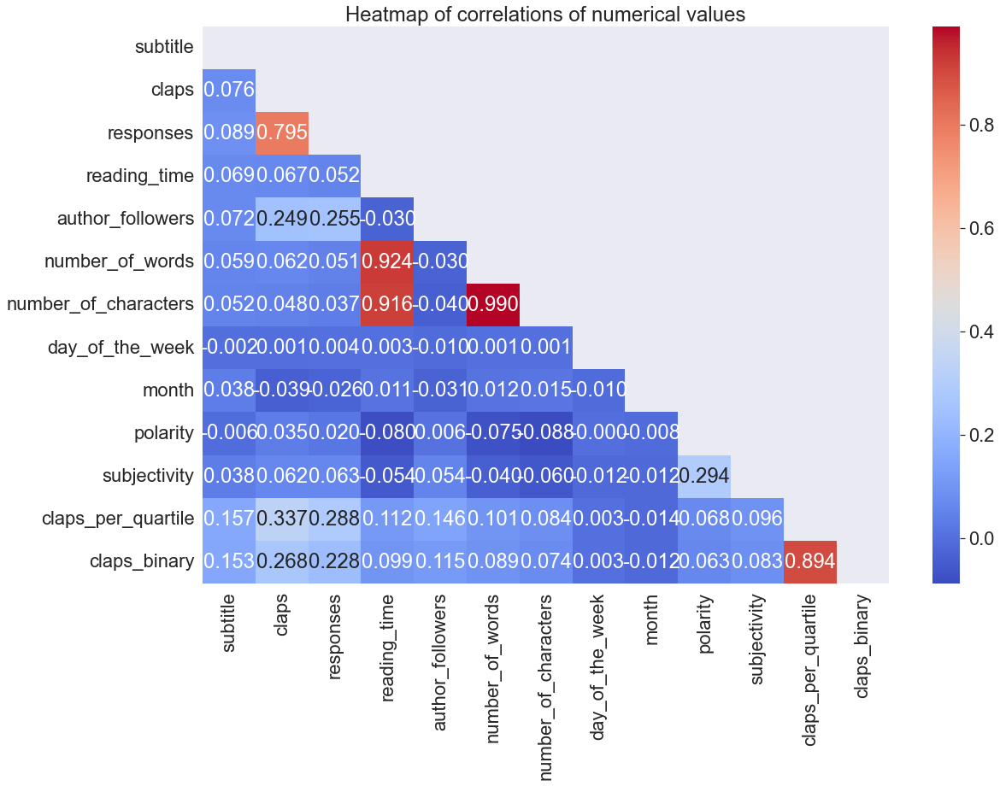

In [9]:
fig, ax = plt.subplots(figsize=(18,12))

mask = np.zeros_like(df.corr(), dtype=bool)
mask[np.triu_indices_from(mask)] = True

plt.title('Heatmap of correlations of numerical values')
sns.heatmap(df.corr(), annot=True, fmt='.3f', ax=ax, mask=mask, cmap='coolwarm')
plt.show()

## Scatter plots for features agaisnt Claps

In [10]:
def plot_scatter(df, y):
    for i in range(len(df.columns)):
        if df[df.columns[i]].dtype !=  'O':
            plt.figure(figsize=(8,6))
            plt.xlabel(df.columns[i])
            plt.title(f'Scatter Plot of {df.columns[i]} against Target')
            sns.scatterplot(x = df[df.columns[i]], y=y, data=df)
            plt.show()

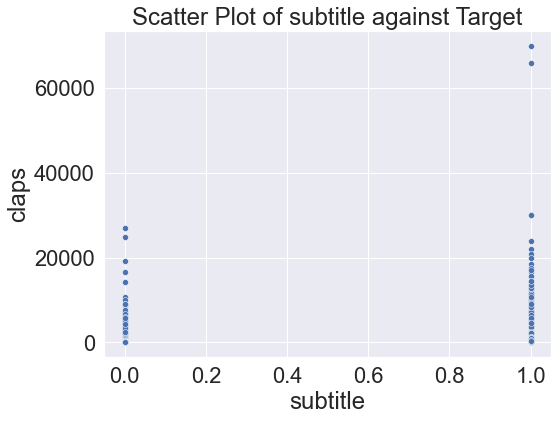

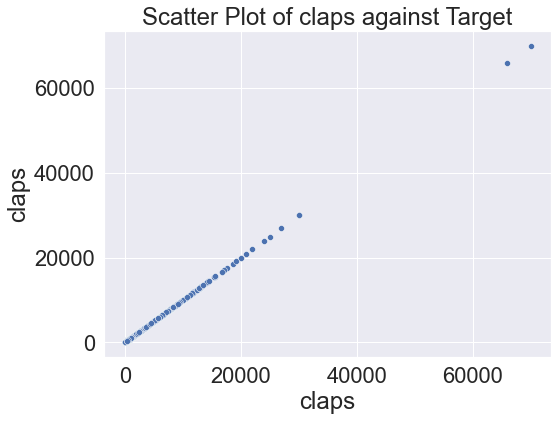

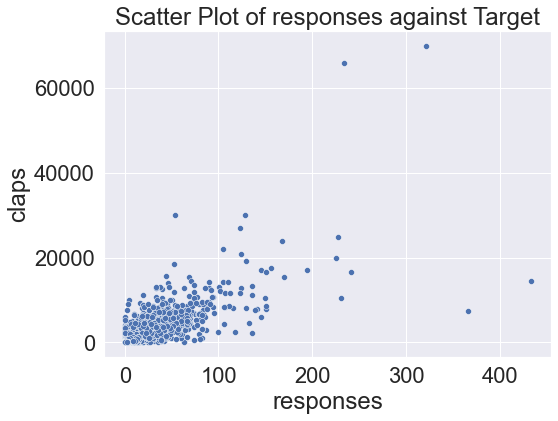

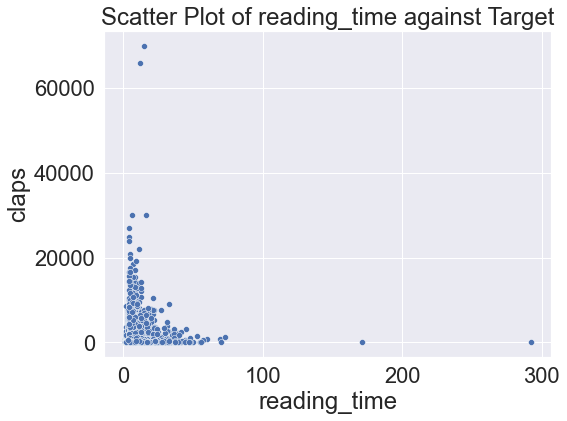

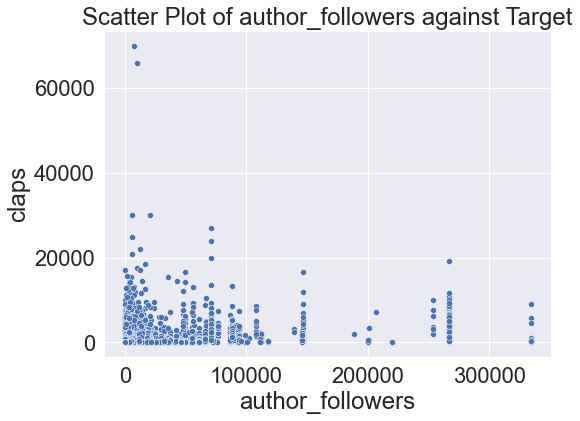

...

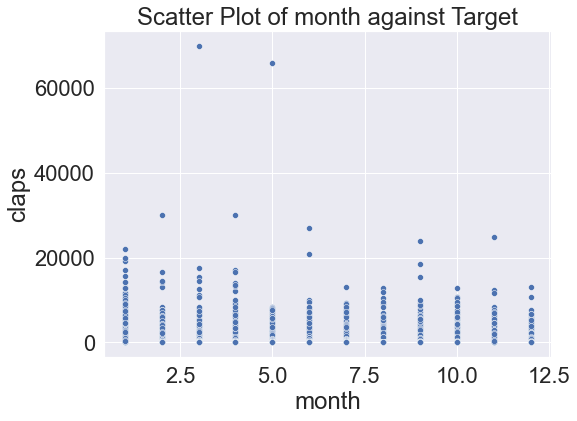

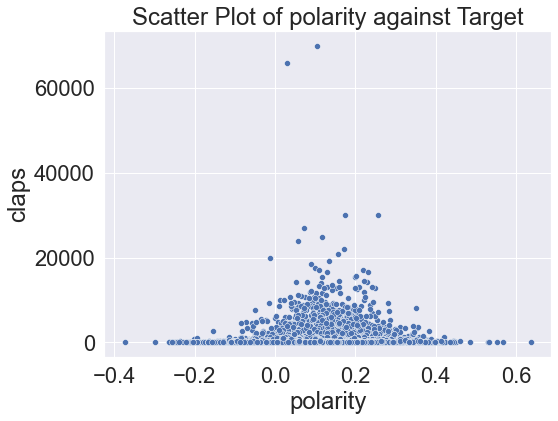

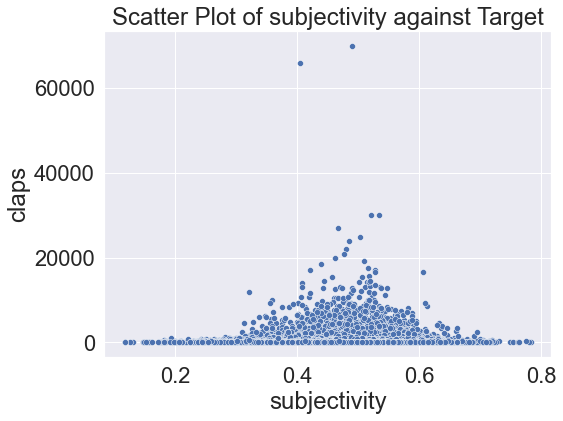

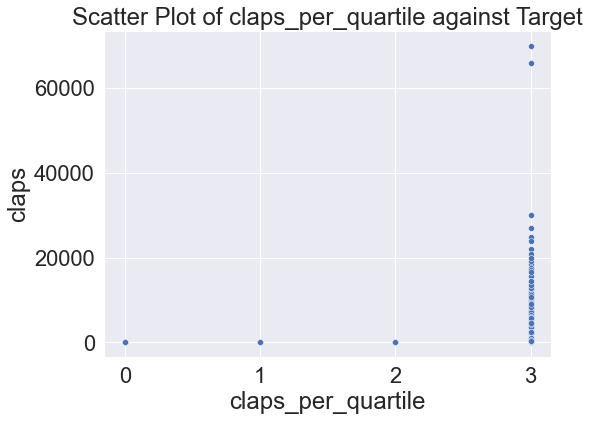

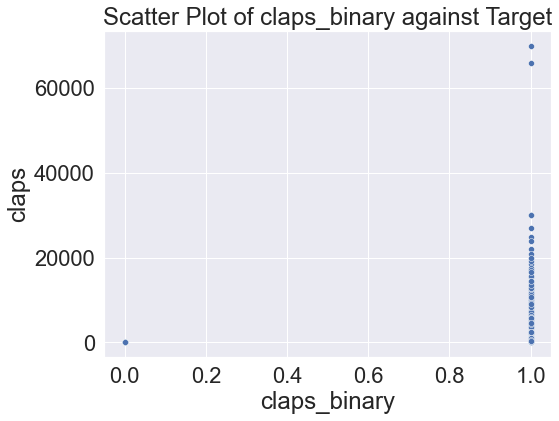

In [11]:
plot_scatter(df, df['claps'])

### IQR and check for outliers 

Keep outliers in first, then change hypothesis to less samples

In [12]:
#df = df[(df.reading_time < 100) & (df.claps <= 10000) & (df.author_followers < 10000)]

In [13]:
claps = df['claps']

lq = claps.quantile(0.25)
uq = claps.quantile(0.75)
iqr = claps.quantile(0.75)-claps.quantile(0.25)

print(f'Lower Quartile --> {lq}')
print(f'Upper Quartile --> {uq}')
print(f'IQR --> {iqr}')

print('Upper Bound', uq + iqr*1.5)
print('Lower Bound', lq-iqr*1.5)

Lower Quartile --> 40.0
Upper Quartile --> 222.0
IQR --> 182.0
Upper Bound 495.0
Lower Bound -233.0


## Deeper vew of some Scatter plots

In [14]:
fig = px.scatter(df,y='claps', x='reading_time', title='Read time vs Claps', color='publication', opacity=0.7)
fig.show()

In [20]:
fig = px.scatter(df,y='claps', x='subjectivity', title='Subjectivty vs Claps', color='publication', opacity=0.7)
fig.show()

In [16]:
fig = px.scatter(df,y='claps', x='polarity', title='Polarity vs Claps', color='publication', opacity=0.7)
fig.show()

In [17]:
fig = px.scatter(df,y='claps', x='number_of_words', title='Number of Words vs Claps', color='publication', opacity=0.7)
fig.show()

In [18]:
fig = px.scatter(df,y ='claps', x='responses', title='Claps vs Response', color='publication')
fig.show()

In [19]:
fig = px.scatter(df,y ='number_of_words', x='responses', title='Number of Words vs Response', color='publication')
fig.show()

----

## Histograms

### Claps

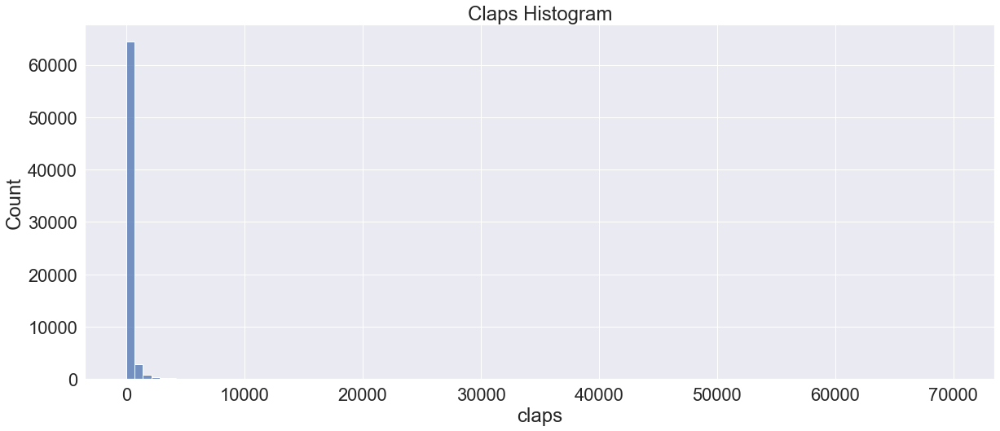

In [20]:
plt.figure(figsize=(20,8))
sns.histplot(df.claps, bins=100);
plt.title('Claps Histogram')
plt.show()

/Users/ariklevy/opt/anaconda3/envs/firstEnv/lib/python3.10/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/Users/ariklevy/opt/anaconda3/envs/firstEnv/lib/python3.10/site-packages/seaborn/distributions.py:2103: FutureWarning:

The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.



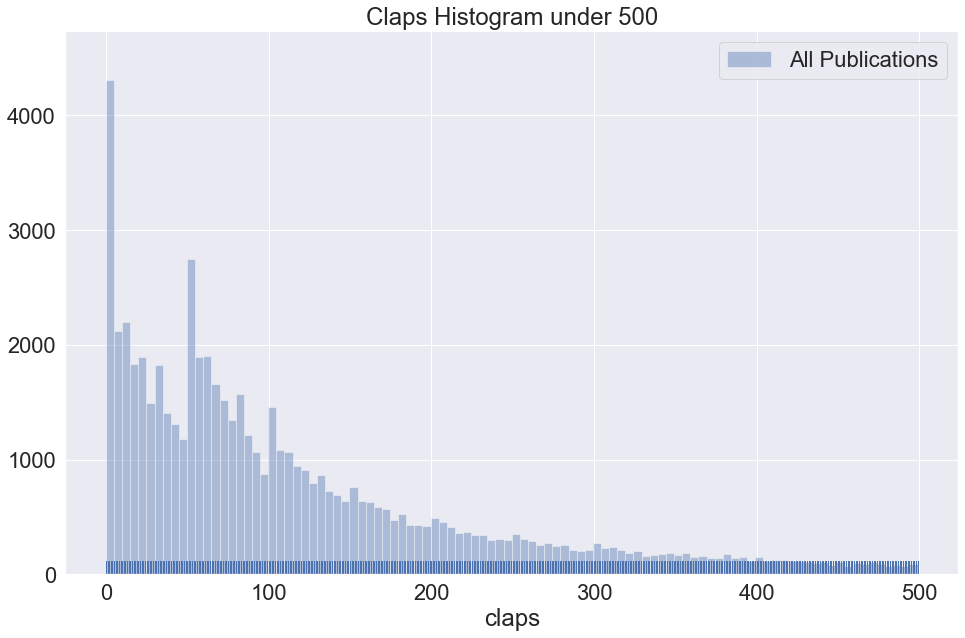

In [21]:
fig, ax = plt.subplots(figsize=(16, 10))

sns.distplot(df[(df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='All Publications')
plt.title('Claps Histogram under 500')

ax.legend()
plt.show()

In [22]:
df.publication.value_counts()

towardsdatascience    27195
datadriveninvestor    14261
swlh                   9986
uxdesign               6553
writingcooperative     4448
better-marketing       4418
better-humans          1506
the-mission             472
startup-grind           296
uxplanet                 35
personal-growth          18
Name: publication, dtype: int64

In [23]:
import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

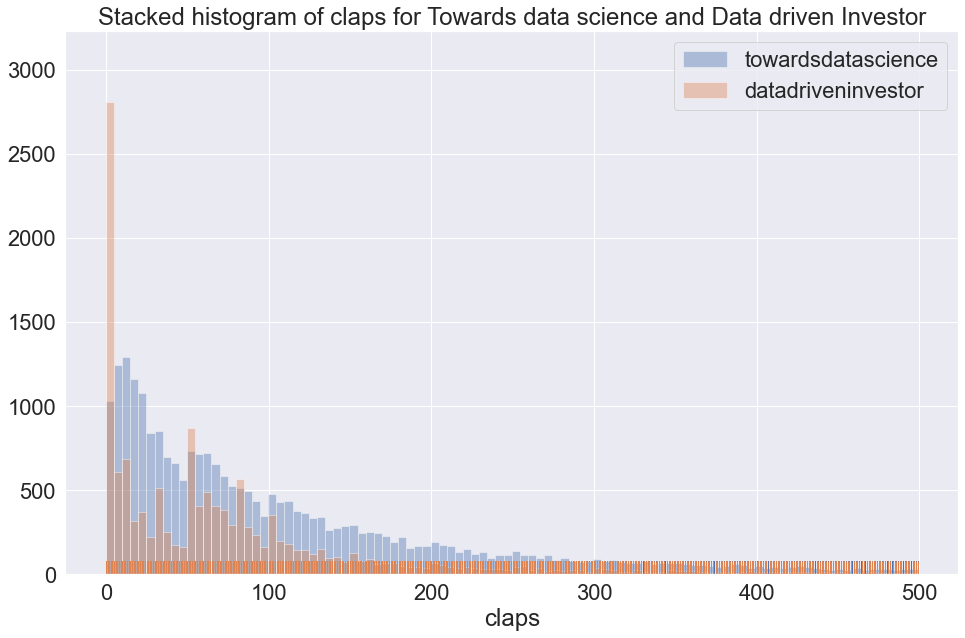

In [24]:
fig, ax = plt.subplots(figsize=(16, 10))

sns.distplot(df[(df.publication=='towardsdatascience') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='towardsdatascience')
sns.distplot(df[(df.publication=='datadriveninvestor') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='datadriveninvestor')

plt.title('Stacked histogram of claps for Towards data science and Data driven Investor')
ax.legend()
plt.show()

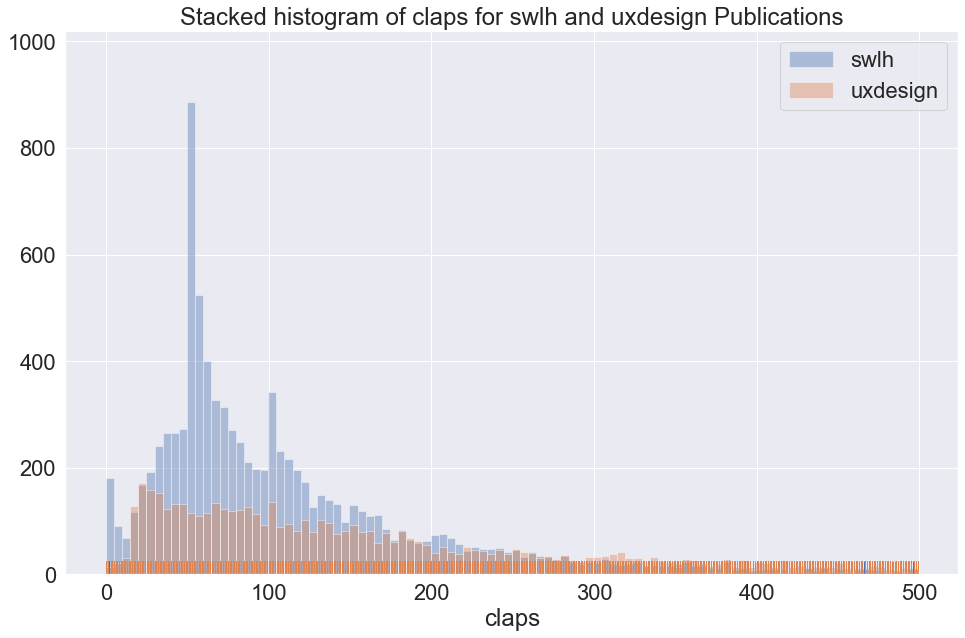

In [53]:
fig, ax = plt.subplots(figsize=(16, 10))

sns.distplot(df[(df.publication=='swlh') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='swlh')
sns.distplot(df[(df.publication=='uxdesign') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='uxdesign')

plt.title('Stacked histogram of claps for swlh and uxdesign Publications')
ax.legend()
plt.show()

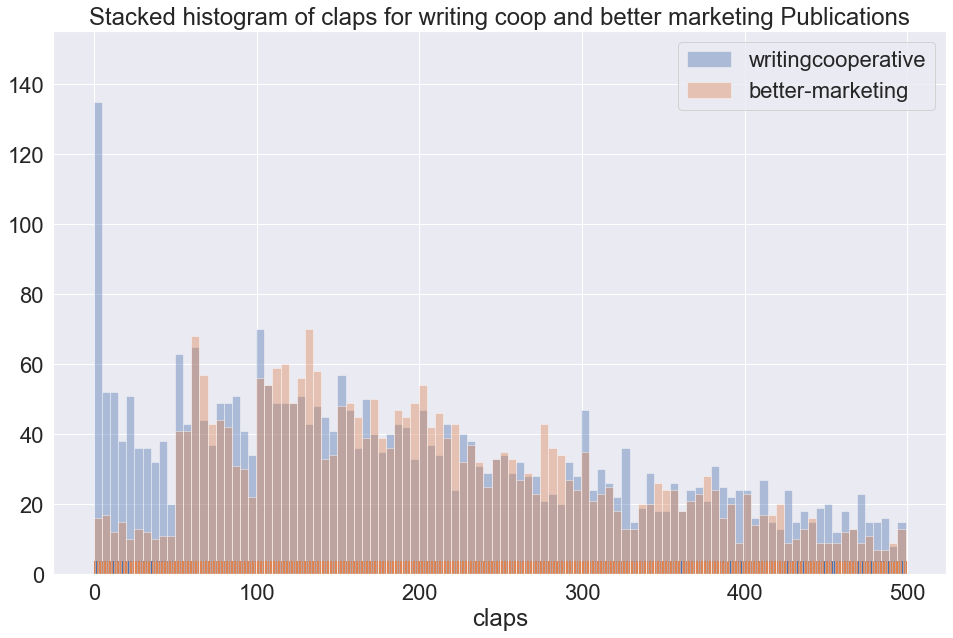

In [26]:
fig, ax = plt.subplots(figsize=(16, 10))

sns.distplot(df[(df.publication=='writingcooperative') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='writingcooperative')
sns.distplot(df[(df.publication=='better-marketing') & (df.claps < 500)]['claps'], bins=100, kde=False, rug=True, ax=ax,  label='better-marketing')

plt.title('Stacked histogram of claps for writing coop and better marketing Publications')
ax.legend()
plt.show()

### Responses

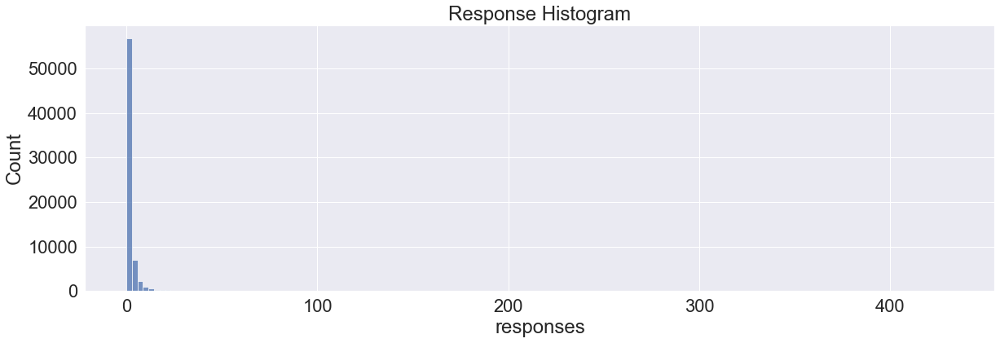

In [27]:
plt.figure(figsize=(20,6))
sns.histplot(df.responses, bins=150);
plt.title('Response Histogram')
plt.show()

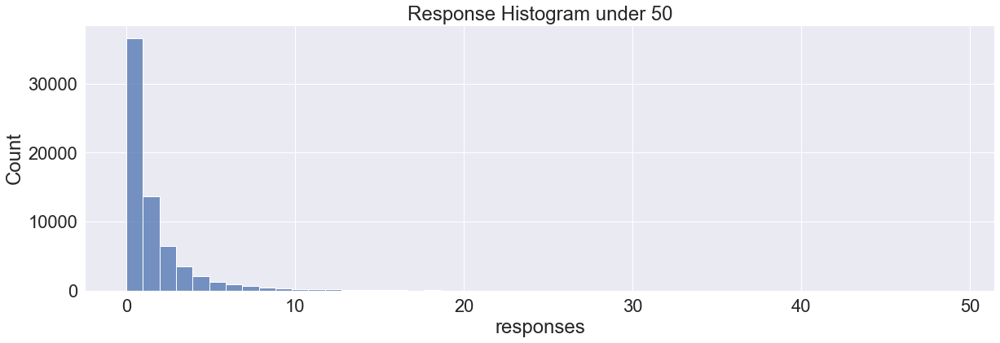

In [28]:
plt.figure(figsize=(20,6))
sns.histplot(df[df.responses < 50]['responses'], bins=50);
plt.title('Response Histogram under 50')
plt.show()

### Reading time

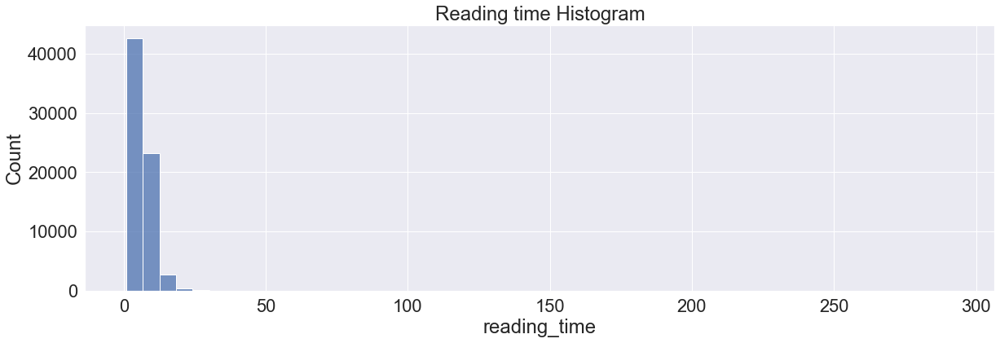

In [29]:
plt.figure(figsize=(20,6))
sns.histplot(df['reading_time'], bins=50);
plt.title('Reading time Histogram')
plt.show()

### Author followers

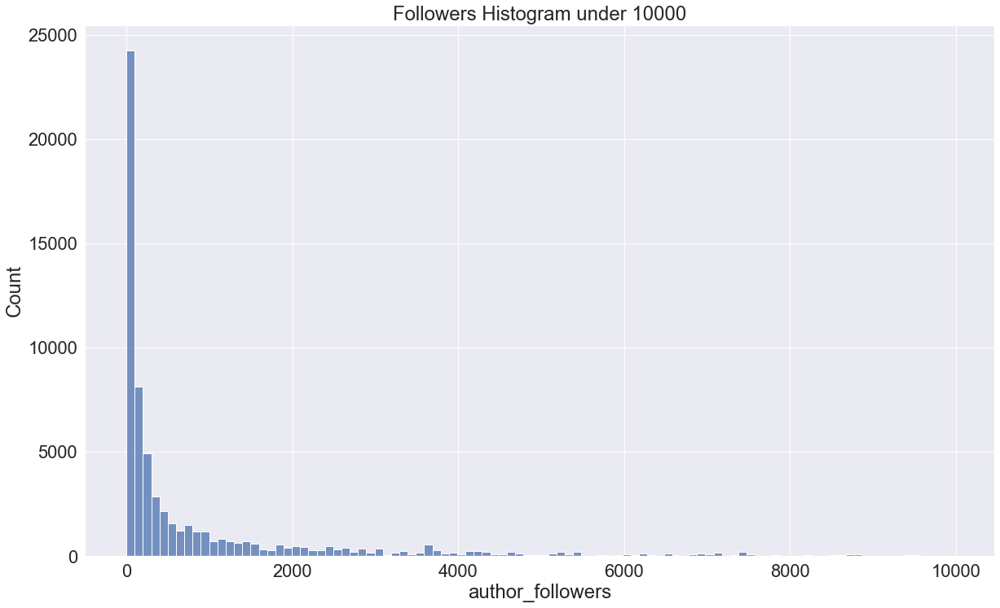

In [30]:
plt.figure(figsize=(20,12))
sns.histplot(df[df['author_followers'] < 10000]['author_followers'], bins=100);
plt.title('Followers Histogram under 10000')
plt.show()

### Word Count

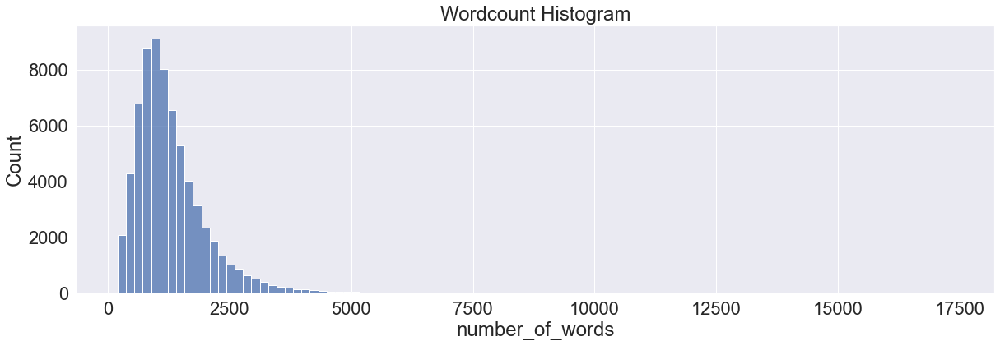

In [31]:
plt.figure(figsize=(20,6))
sns.histplot(df['number_of_words'], bins=100);
plt.title('Wordcount Histogram')
plt.show()

### Distribution of polarity

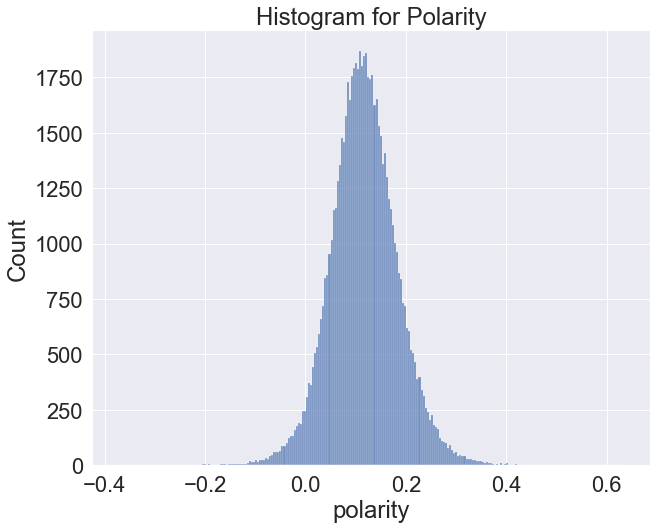

In [32]:
plt.figure(figsize=(10,8))
plt.title('Histogram for Polarity')
sns.histplot(df.polarity);

### Distribution of polarity and Subjectivity

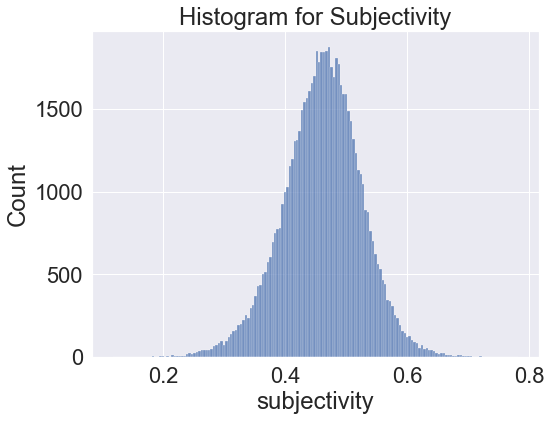

In [33]:
plt.figure(figsize=(8,6))
plt.title('Histogram for Subjectivity')
sns.histplot(df.subjectivity);

------------

--------

## Articles per publication

In [34]:
df.publication.value_counts()

towardsdatascience    27195
datadriveninvestor    14261
swlh                   9986
uxdesign               6553
writingcooperative     4448
better-marketing       4418
better-humans          1506
the-mission             472
startup-grind           296
uxplanet                 35
personal-growth          18
Name: publication, dtype: int64

### Removing uxplanet and personal-growth as not many articles survived the cleaning process

In [35]:
df = df[(df['publication'] != 'personal-growth') & (df['publication'] != 'uxplanet')]

### Number of articles per publication

In [36]:
fig = px.bar(x=list(df['publication'].value_counts().index), y=list(df['publication'].value_counts()))
fig.show()

### Boxplot of claps per publication

In [37]:
fig = px.box(df,x='publication', y='claps', title='Box plot claps')
fig.show()

### Average length of text per publication

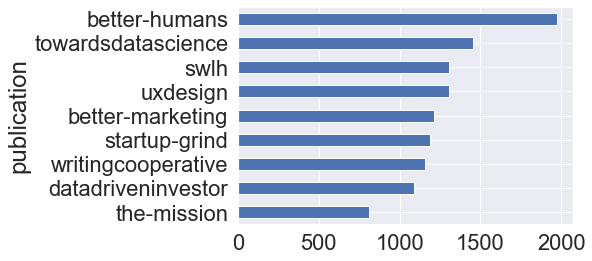

In [38]:
df.groupby('publication')['number_of_words'].mean().sort_values().plot(kind='barh');

## How many articles per writer

In [39]:
print(f'There are {len(df.author_handle.unique())} unique writers')

There are 23338 unique writers


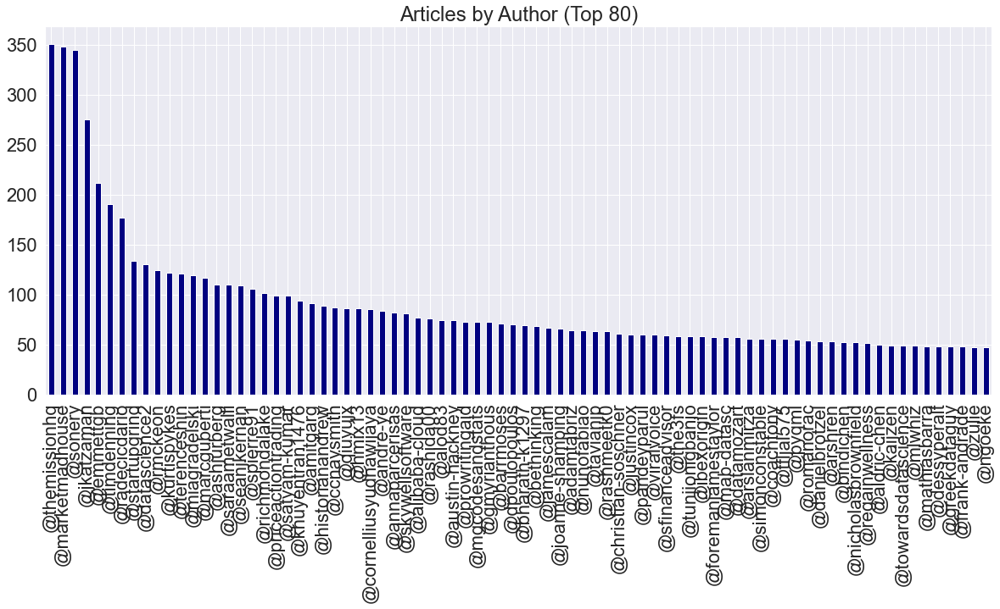

In [40]:
plt.figure(figsize=(20,8))
plt.title('Articles by Author (Top 80)')
df.author_handle.value_counts()[:80].plot(kind='bar', colormap='jet');

In [41]:
author_df = pd.DataFrame(df.groupby('author_handle')['text'].count())
len(author_df[author_df['text'] == 1])

13079

--------

## Engagement per publication, ie claps and responses

### Claps

In [42]:
df.groupby('publication')['claps'].mean().sort_values()

publication
startup-grind         108.462838
datadriveninvestor    114.526260
the-mission           133.682203
swlh                  165.172041
towardsdatascience    182.226770
uxdesign              395.463452
writingcooperative    481.649505
better-marketing      791.043006
better-humans         807.508632
Name: claps, dtype: float64

### Responses

In [43]:
df.groupby('publication')['responses'].mean().sort_values()

publication
startup-grind         0.564189
datadriveninvestor    0.846014
swlh                  0.954236
the-mission           1.097458
towardsdatascience    1.436183
uxdesign              1.886464
writingcooperative    4.646583
better-humans         6.186587
better-marketing      6.466274
Name: responses, dtype: float64

In [44]:
for pub in df.publication.unique():
    fig = px.scatter(df[df.publication == pub], y ='claps', 
                     x='reading_time', title= f'Reading Time vs Claps for {pub}', color='publication')
    fig.show()

------

## Word Clouds

In [45]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [46]:
text = " ".join(article for article in df.text)
print ("There are {} words combined.".format(len(text.split())))

There are 48816439 words combined.


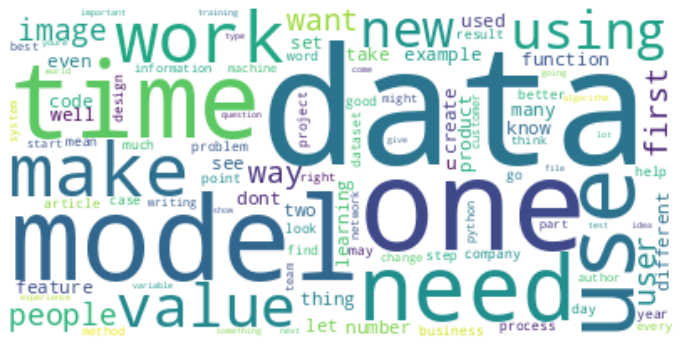

In [47]:
# Generate a word cloud image
wordcloud = WordCloud(collocations = False, max_words=100, background_color="white").generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(12,14))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

###  Wordcloud per publication

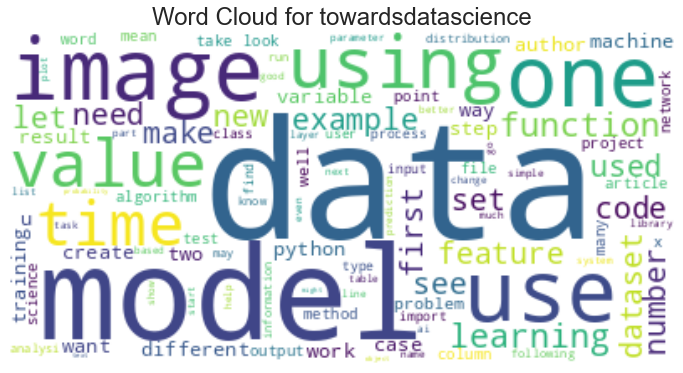

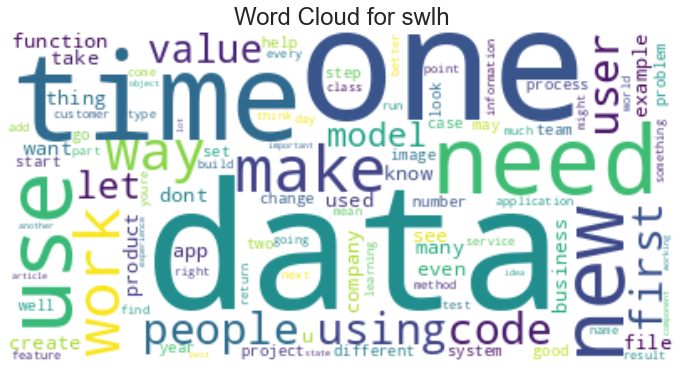

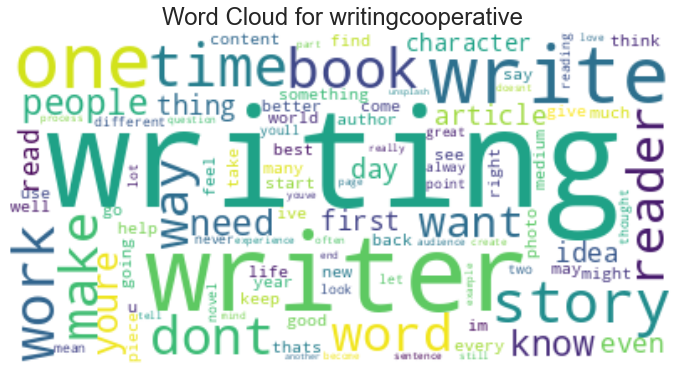

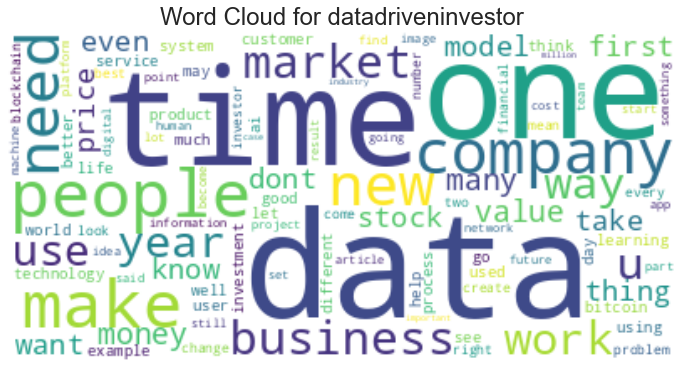

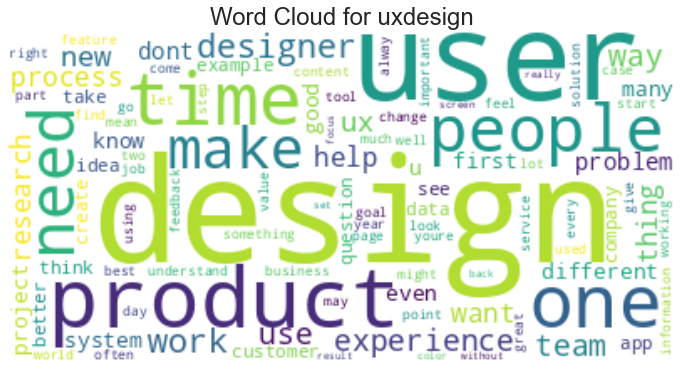

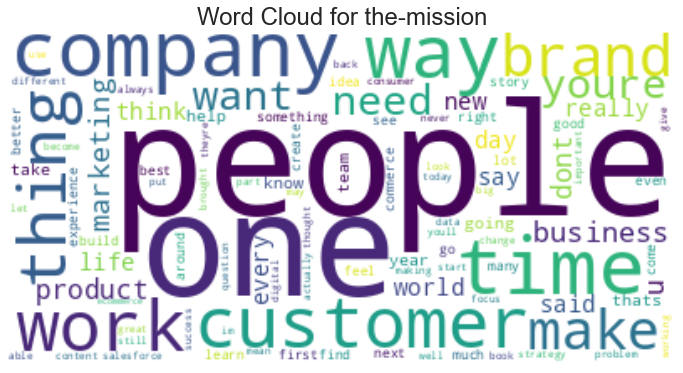

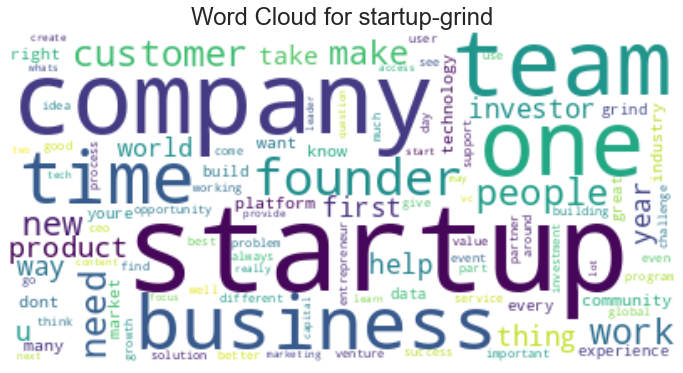

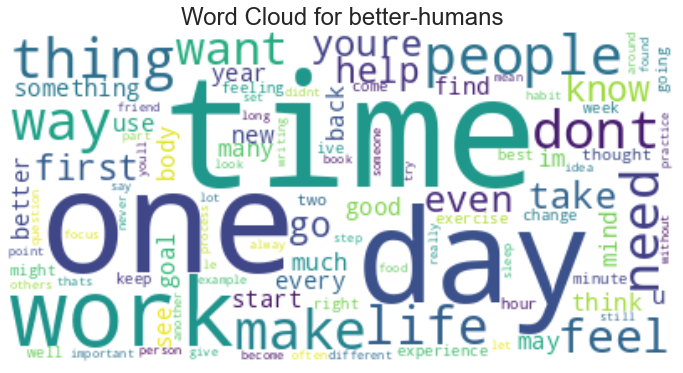

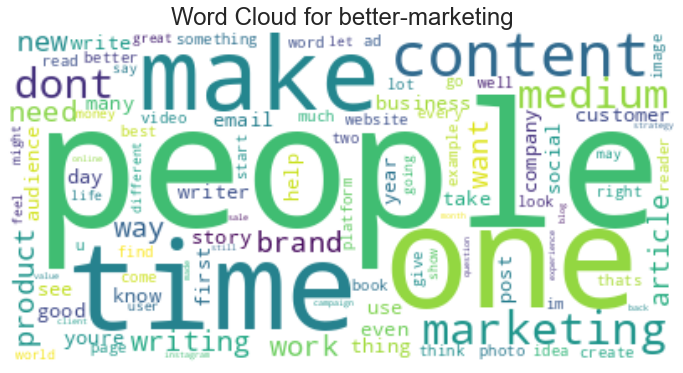

In [48]:
for publication in df.publication.unique():

    text = " ".join(article for article in df[df['publication'] == publication]['text'])
    wordcloud = WordCloud(collocations = False, max_words=100, background_color="white").generate(text)
    
    plt.figure(figsize=(12,14))
    plt.title(f'Word Cloud for {publication}')
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

----------

## Analysis by Quartile

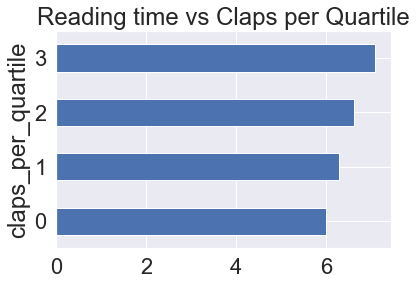

In [49]:
plt.title('Reading time vs Claps per Quartile')
df.groupby('claps_per_quartile')['reading_time'].mean().plot(kind='barh');

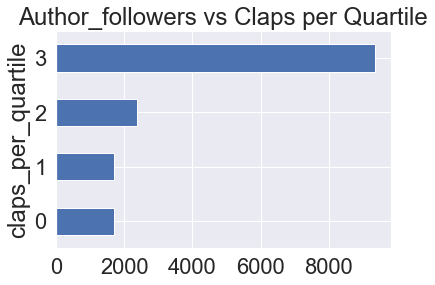

In [50]:
plt.title('Author_followers vs Claps per Quartile')
df.groupby('claps_per_quartile')['author_followers'].mean().plot(kind='barh');

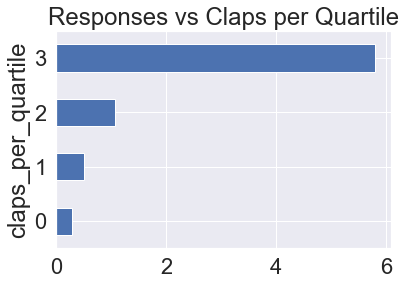

In [51]:
plt.title('Responses vs Claps per Quartile')
df.groupby('claps_per_quartile')['responses'].mean().plot(kind='barh');

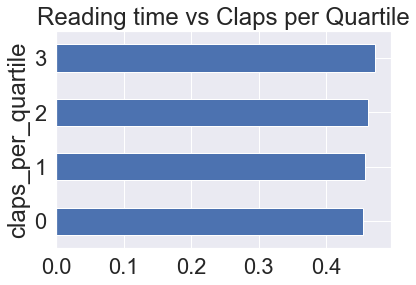

In [52]:
plt.title('Reading time vs Claps per Quartile')
df.groupby('claps_per_quartile')['subjectivity'].mean().plot(kind='barh');

--------